##**Algoritmo Wordpiece:**

WordPiece divide el texto en unidades más pequeñas llamadas subpalabras. Estas subpalabras pueden ser partes de palabras o incluso palabras completas, dependiendo de la frecuencia con la que aparecen en un corpus de entrenamiento. Esto ayuda a abordar el problema de la rareza de palabras y permite que el modelo comprenda mejor el significado incluso de palabras poco comunes o inventadas.

Veamos un ejemplo:

In [1]:
!pip install transformers -q

In [38]:
from transformers import BertModel, BertTokenizer
import torch
#PACKAGES:
import torch
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import matplotlib.pyplot as plt
from sklearn.manifold import TSNE
from scipy.special import softmax

In [3]:
tokenizer = BertTokenizer.from_pretrained('bert-base-uncased') #BERT Tokenizer

/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:88: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


tokenizer_config.json:   0%|          | 0.00/48.0 [00:00<?, ?B/s]

vocab.txt:   0%|          | 0.00/232k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/466k [00:00<?, ?B/s]

config.json:   0%|          | 0.00/570 [00:00<?, ?B/s]

In [4]:
sentence = 'She is a MachineLearning Engineer and works in California'

In [5]:
word_pieces = tokenizer.tokenize(sentence) #Obtenemos las piezas de palabras o subtokens de la oraciòn
word_pieces

['she',
 'is',
 'a',
 'machine',
 '##lea',
 '##rn',
 '##ing',
 'engineer',
 'and',
 'works',
 'in',
 'california']

**Ventaja de WordPiece:** En este caso, el usuario se equivoca y escribe la palabra "MachineLearning" como una sola palabra; que por su puesto es una palabra que no està en el vocabulario con que fue pre-entrenado BERT; esta es la razòn por la cual esta palabra se divide en sub-palabras o piezas de palabras que sì estàn en el vocabulario con que fue pre-entrenado BERT.

De esta manera, podemos definir nuestra oraciòn de entrada como un conjunto de sub-palabras:

$\{w_i \in \Omega\}_{i=1}^{N_w}$

Donde $N_w$ es la cantidad de sub-tokens de la oración.

Ahora, a cada una de estas sub-palabras se le asigna un id. Si deseas saber como es la construcción de estos ids para cada una de las sub-palabras del vocabulario a través del algoritmo WordPiece, dirigete al siguiente [Notebook](https://github.com/UN-GCPDS/Curso-Procesamiento-de-Lenguaje-Natural-NLP-/blob/main/Modelos%20Word2Vec%20y%20Tokenizadores/WordPiece_Algorithm.ipynb\)

In [7]:
vector_ids=tokenizer(sentence).input_ids
vector_ids

[101,
 2016,
 2003,
 1037,
 3698,
 19738,
 6826,
 2075,
 3992,
 1998,
 2573,
 1999,
 2662,
 102]

Como se puede ver, al inicio de la oración, se agrega el id **101** que corresponde al sub-token especial **[CLS]** para indicar que la oración comienza. Así mismo, al final de la oración, se agrega el id **102** que corresponde al sub-token especial **[SEP]** para indicar que la oración termina.

De esta manera, podemos definir nuestra oraciòn como un vector de ids:

$\mathbf{X} \in \mathbb{N}^{N_{id}}$

Donde $N_{id}$ es la cantidad de sub-tokens de la oración incluyendo los dos sub-tokens especiales mencionados anteriormente.

Sin embargo, para hallar la representación contextual (embedding) de cada uno de los sub-tokens a través del modelo pre-entrenado de BERT, debemos garantizar que todas las oraciones con las que trabajamos tengan la misma longitud. Para lograr esto, nos apoyamos del **padding** y de la **truncation**. Veamos esto con un ejemplo:

In [8]:
#Si  tenemos la siguiente oración:
sentence="El sol se oculta tras las montañas, pintando el cielo de tonos cálidos."

#El siguiente sería el vector de ids, sin aplicar truncation y/o padding para lograr un vector de longitud fija:
vector_ids=tokenizer(sentence).input_ids
vector_ids

[101,
 3449,
 14017,
 7367,
 1051,
 10841,
 24458,
 19817,
 3022,
 5869,
 8124,
 2015,
 1010,
 9231,
 5794,
 3527,
 3449,
 25022,
 18349,
 2139,
 10228,
 2891,
 10250,
 13820,
 2015,
 1012,
 102]

In [9]:
#Ahora, tomemos la misma oración pero agregandole y quitandole palabras:
sentences=["""El sol se oculta tras las montañas, pintando el cielo de tonos cálidos. El viento susurra entre los árboles,
 llevando consigo el aroma fresco del bosque. Es el momento en que el día se despide y la noche toma su lugar.""","el sol se oculta tras las montañas"]

#Ahora, obtenemos el vector de ids de cada una de estas oraciones estableciendo una longitud fija de 20 sub-tokens y aplicando padding y truncation
batch=tokenizer(sentences,max_length=20, padding=True, truncation=True, return_tensors="pt")
batch["input_ids"][0], batch["input_ids"][1]

(tensor([  101,  3449, 14017,  7367,  1051, 10841, 24458, 19817,  3022,  5869,
          8124,  2015,  1010,  9231,  5794,  3527,  3449, 25022, 18349,   102]),
 tensor([  101,  3449, 14017,  7367,  1051, 10841, 24458, 19817,  3022,  5869,
          8124,  2015,   102,     0,     0,     0,     0,     0,     0,     0]))

**Observaciones:**

1. En la primera oración se puede ver que al establecer una longitud fija de secuencia de 20, el vector de ids se ve truncado para lograr esto.

2. En la segunda oración se puede ver que al establecer una longitud fija de secuencia de 20, al vector de ids se le debe aplicar para completar dicho tamaño.

3. Para elegir la longitud fija de secuencia no hay una formula mágica; Es por esto que se debe conocer muy bien nuestro dataset, con el fin de saber en promedio cuantos sub-tokens tienen las muestras de texto.

Por otro lado, además de obtener el vector de ids, también obtenemos un vector llamado **Attention Mask**, que nos permite saber si cada uno de los ids del vector de ids es padding o no. Este vector lo podemos representar matematicamente como:

$\mathbf{Z} \in \{0,1\}^{N_{id}}$

Donde se tomará el valor de 0 en caso de que en la respectiva posición del vector de ids halla padding y se tomará el valor de 1 en caso contrario.

In [10]:
batch["attention_mask"][0], batch["input_ids"][1]

(tensor([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]),
 tensor([  101,  3449, 14017,  7367,  1051, 10841, 24458, 19817,  3022,  5869,
          8124,  2015,   102,     0,     0,     0,     0,     0,     0,     0]))

Como se puede ver, efectivamente en la primera oración que no hubo paddin, mientras que en la segunda sí; debido a que se definió la longitud fija de todas las oraciones.

##**Obteniendo Embedding de Cada Sub-Palabra a Partir del Modelo Pre-Entrenado de BERT:**

Ahora, procedemos a utilizar el modelo pre-entrenado de BERT para obtener la representación contextual o representación semántica de cada sub-palabra de la oración. Esto lo podemos representar matemáticamente como:

$\mathbf{X} \in \mathbb{R}^{N_{id}Xd}$

Donde N es el número de sub-palabras de la oración y d es la longitud del embebbing representación contextual de cada sub-palabra (En este caso 768).

La forma en la que se plantea el costo para Pre-Entrenar BERT la veremos más adelante, sin embargo es a través de las conocidas técnicas **"Mask Languaje Models"** y "**Next Sentence Prediction**". Si deseas más información dirigete al paper de [BERT](https://arxiv.org/pdf/1810.04805#page=12&zoom=100,89,404).

Veamos esto con un ejemplo de tres oraciones de diferentes longitudes:

In [11]:
#Tenemos las siguientes tres oraciones de diferentes longitudes:
sentences=["El sol se oculta tras las montañas, pintando el cielo de tonos cálidos.",
           """En un pequeño pueblo perdido entre valles y colinas, la vida transcurría con la calma propia de los lugares olvidados por el tiempo.
           Las casas de piedra, con sus tejados cubiertos de musgo, parecían fundirse con el paisaje que las rodeaba. En la plaza central,
           un antiguo reloj de torre marcaba imperturbable el paso de las horas, testigo silencioso de generaciones enteras.
           Los habitantes, de rostros curtidos por el sol y las historias compartidas alrededor de la hoguera, encontraban en la sencillez de su rutina
           la verdadera riqueza de la vida.""",
           """En el corazón de la ciudad, donde el bullicio y el ritmo frenético de la vida moderna dominaban cada rincón, se alzaba un edificio de
           aspecto imponente. Sus altas torres de cristal reflejaban la luz del sol, creando destellos que se perdían en el horizonte urbano.
           En su interior, un laberinto de pasillos y escaleras conectaba las innumerables oficinas donde se tomaban decisiones que afectaban el
           destino de miles de personas. Era el centro neurálgico de la economía, donde el poder y el dinero se entrelazaban en una danza eterna.
           Pero detrás de la fachada de éxito y prosperidad, se escondían secretos oscuros. Corredores corruptos, tratos sucios y ambiciones desmedidas
           teñían de sombras los pasillos iluminados por la luz artificial. Aquí, el valor de una vida se medía en cifras en una pantalla, y la lealtad
            era un bien escaso que se compraba al mejor postor.
            Sin embargo, entre la maraña de intereses y agendas ocultas, algunos buscaban una luz de esperanza.
            Pequeños gestos de bondad, actos de valentía silenciosa, que recordaban a todos que, incluso en el corazón de la oscuridad,
            aún podía encontrarse la llama de la humanidad. Y así, en ese rincón de acero y cristal, la lucha entre el bien y el mal,
            entre la codicia y la compasión, continuaba su eterno curso, mientras el mundo giraba sin cesar en su incesante carrera hacia el futuro."""]

In [29]:
#Ahora, obtenemos el vector de ids de cada una de estas oraciones estableciendo una longitud fija de 512 sub-tokens y aplicando padding y truncation
batch=tokenizer(sentences,max_length=450, padding=True, truncation=True, return_tensors="pt")
input_ids=batch["input_ids"]
attention_mask=batch["attention_mask"]
input_ids

tensor([[  101,  3449, 14017,  ...,     0,     0,     0],
        [  101,  4372,  4895,  ...,     0,     0,     0],
        [  101,  4372,  3449,  ...,  2080,  1012,   102]])

In [18]:
attention_mask

tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]])

In [13]:
model = BertModel.from_pretrained('bert-base-uncased') #Load the BERT Pre-Trained Model

In [34]:
outputs = model(input_ids, attention_mask = attention_mask)[0] #Get the contextutal representation of every sub-word of the sentence.

In [35]:
outputs.shape

torch.Size([3, 450, 768])

In [67]:
#Obtenemos las sub-palabras de cada oración:
name_tokens=[]
for sent in sentences:
  tokens = tokenizer.tokenize(sent)
  tokens = ['[CLS]'] + tokens + ['[SEP]']
  while(len(tokens)<450):
    tokens = tokens + ['[PAD]']
  name_tokens.append(tokens)

Veamos la representación contextual de los tokens en un mapa de calor para cada una de las oraciones.

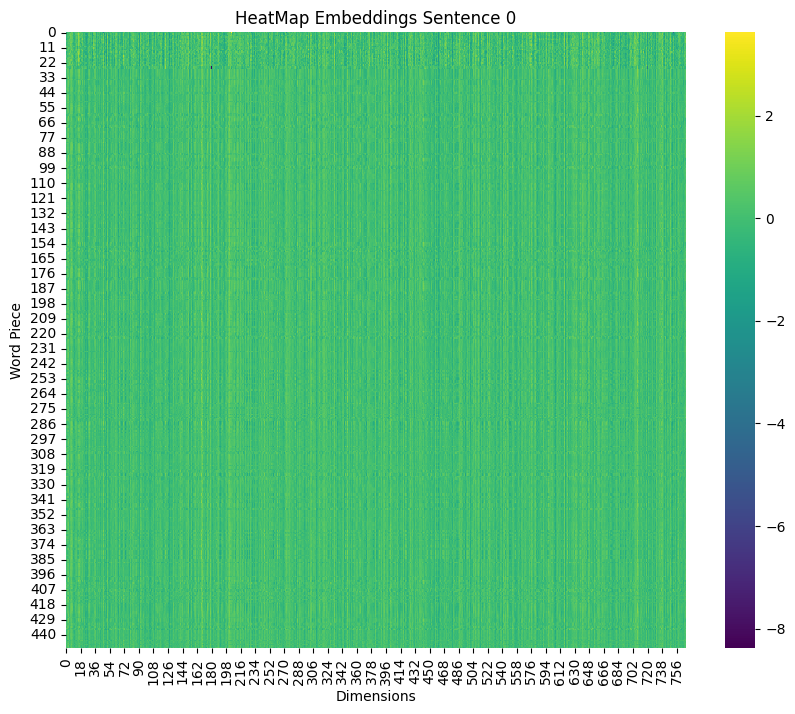

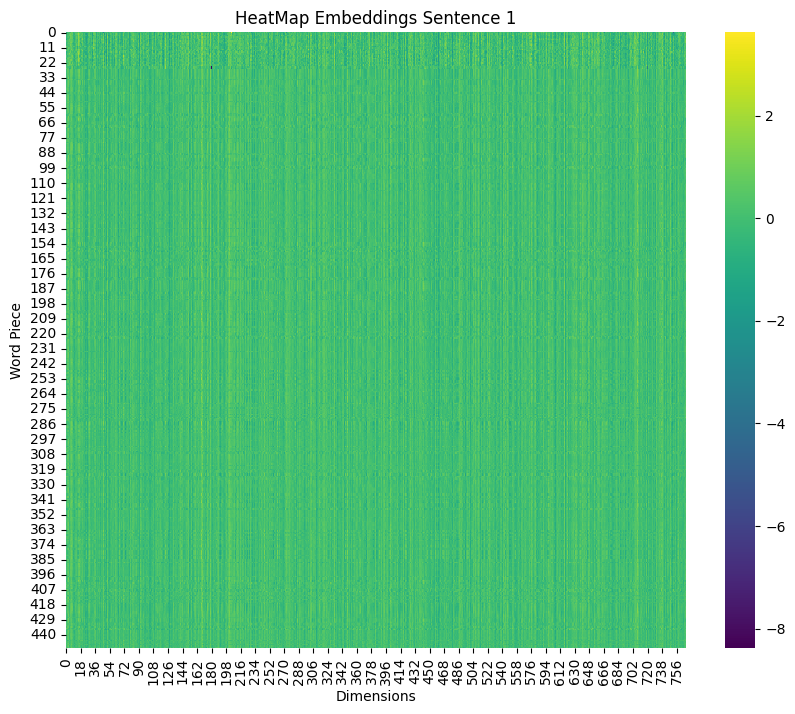

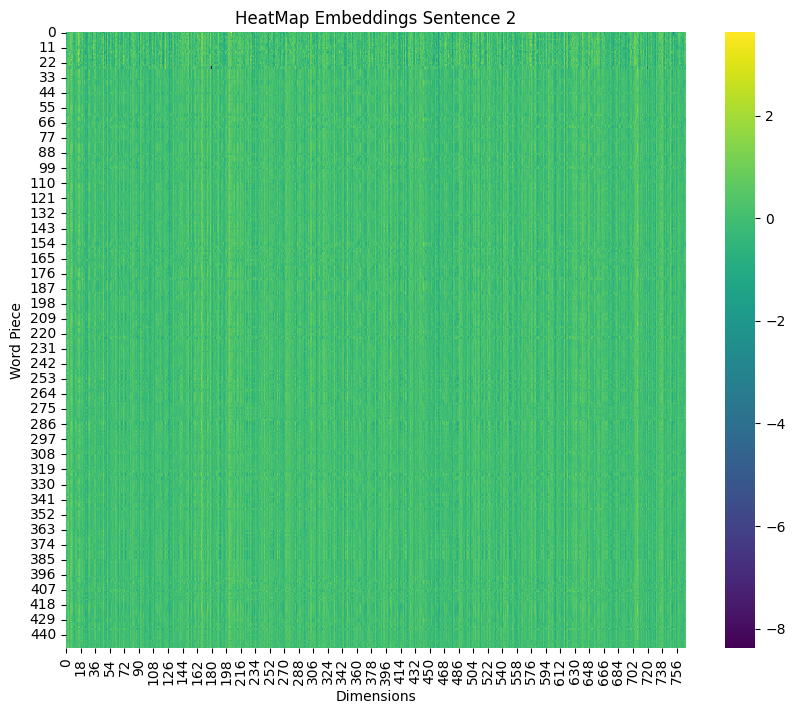

In [71]:
embeddings=[]
for i in range(outputs.shape[0]):
  embedding=outputs[0].detach().numpy()
  embeddings.append(embedding)
  vmin = embedding.min()
  vmax = embedding.max()

  # Plot
  plt.figure(figsize=(10, 8))
  sns.heatmap(embedding, cmap='viridis', vmin=vmin, vmax=vmax)
  plt.title(f'HeatMap Embeddings Sentence {i}')
  plt.xlabel('Dimensions')
  plt.ylabel('Word Piece')
  #plt.yticks(ticks=range(450), labels=name_tokens[i],rotation=0)
plt.show()


Ahora, por cada una de las oraciones, hagamos una reducción de dimensión a través de T-SNE, con el fin de ver que palabras se agrupan, es decir, que palabras tienen similitud semántica entre si:

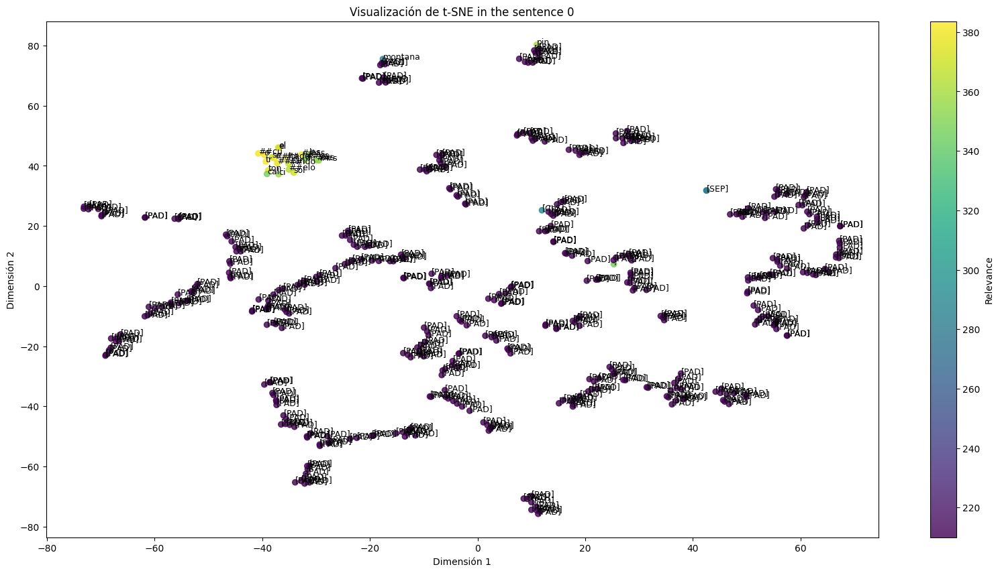

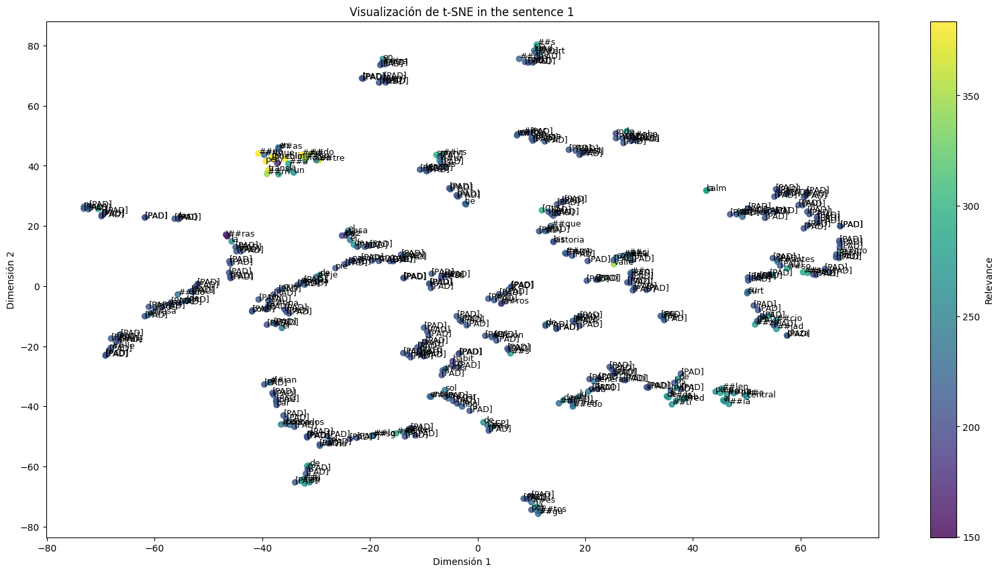

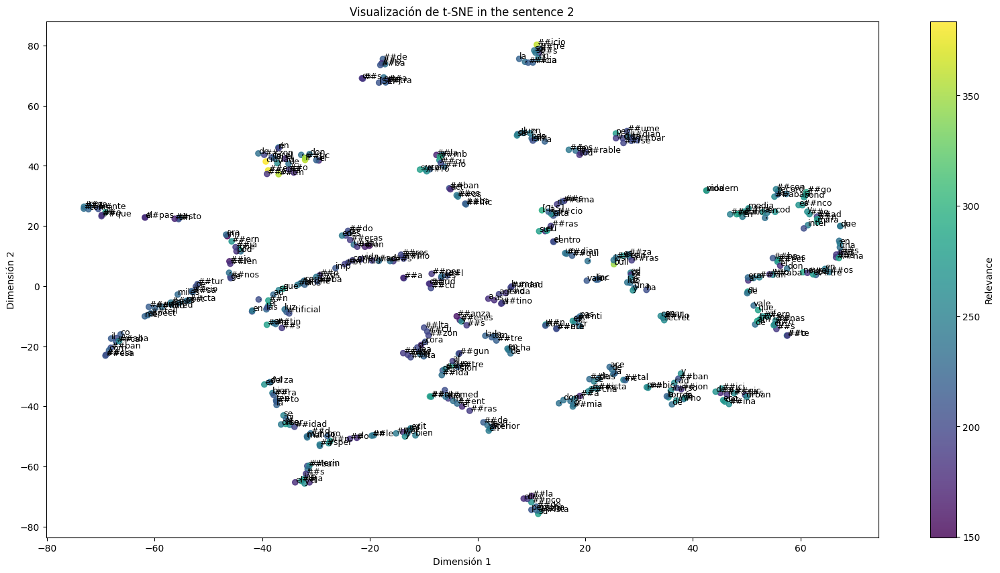

In [65]:
for i in range(outputs.shape[0]):
  # Apply T-SNE to carry to two dimensions
  tsne = TSNE(n_components=2, random_state=42, perplexity=4)
  embedding_two_dimensions = tsne.fit_transform(embeddings[i])


  dic_suma_tokens={}
  for j,token in enumerate(embeddings[i]):
    suma=np.sum(np.abs(token))
    dic_suma_tokens[name_tokens[i][j]]=suma
  words_relevance = np.array([dic_suma_tokens[token] for token in name_tokens[i]])

  # Visualizar el resultado en un scatter plot
  plt.figure(figsize=(20, 10))
  plt.scatter(embedding_two_dimensions[:, 0], embedding_two_dimensions[:, 1], alpha=0.8,cmap="viridis",c=words_relevance)
  plt.colorbar(label='Relevance')  # Etiqueta de la barra de color

  # Enumerar cada punto
  for k, (x, y) in enumerate(embedding_two_dimensions):
      plt.text(x, y, name_tokens[i][k], fontsize=9)

  plt.title(f'Visualización de t-SNE in the sentence {i}')
  plt.xlabel('Dimensión 1')
  plt.ylabel('Dimensión 2')
  plt.show()

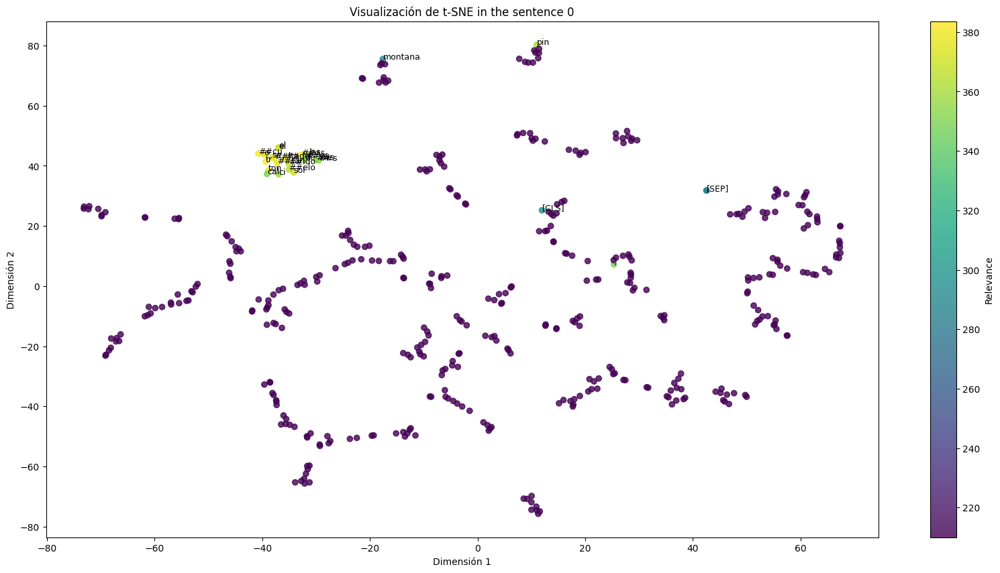

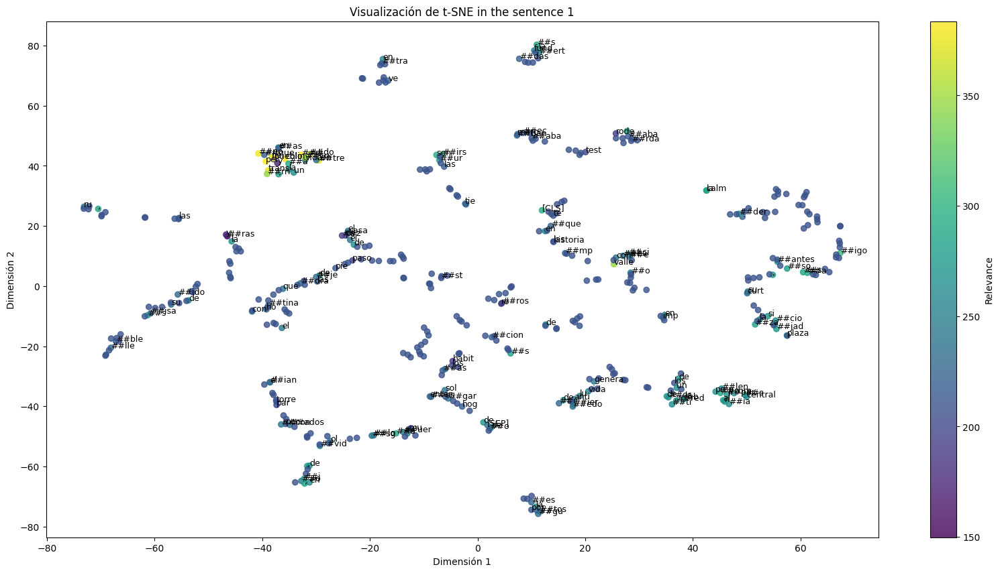

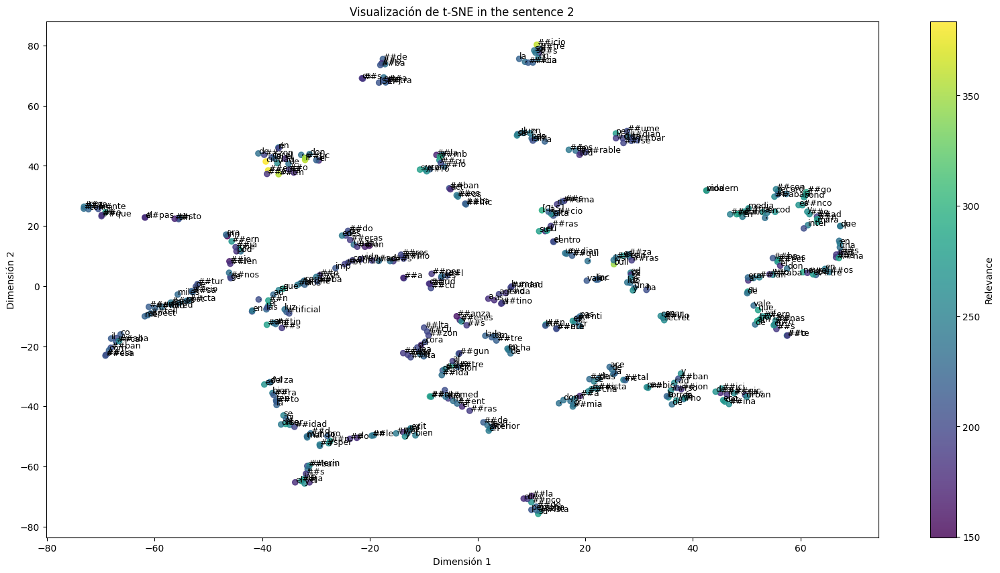

In [66]:
for i in range(outputs.shape[0]):
  # Apply T-SNE to carry to two dimensions
  tsne = TSNE(n_components=2, random_state=42, perplexity=4)
  embedding_two_dimensions = tsne.fit_transform(embeddings[i])


  dic_suma_tokens={}
  for j,token in enumerate(embeddings[i]):
    suma=np.sum(np.abs(token))
    dic_suma_tokens[name_tokens[i][j]]=suma
  words_relevance = np.array([dic_suma_tokens[token] for token in name_tokens[i]])

  # Visualizar el resultado en un scatter plot
  plt.figure(figsize=(20, 10))
  plt.scatter(embedding_two_dimensions[:, 0], embedding_two_dimensions[:, 1], alpha=0.8,cmap="viridis",c=words_relevance)
  plt.colorbar(label='Relevance')  # Etiqueta de la barra de color

  # Enumerar cada punto
  for k, (x, y) in enumerate(embedding_two_dimensions):
      if name_tokens[i][k]=="[PAD]":
        plt.text(x, y, "", fontsize=9)
      else:
        plt.text(x, y, name_tokens[i][k], fontsize=9)

  plt.title(f'Visualización de t-SNE in the sentence {i}')
  plt.xlabel('Dimensión 1')
  plt.ylabel('Dimensión 2')
  plt.show()

##**Positional Embedding:**

Ahora, sumemos matrices de codificación posicional a nuestras oraciones, con el fin de codificar la posición de cada una de las sub-palabras dentro de la oración. Dicha codificación posicional se define de la siguiente manera:

\begin{equation}
\mathbf{X} \in [-1,1]^{N_{id}Xd}
\end{equation}

Donde N es el número de sub-palabras de la oración y d es la longitud del embebbing representación contextual de cada sub-palabra (En este caso 768).

Donde:

\begin{equation}
PE_{(pos, 2i)} = \sin\left(\frac{pos}{10000^{2i/d_{\text{model}}}}\right)
\end{equation}

\begin{equation}
PE_{(pos, 2i+1)} = \cos\left(\frac{pos}{10000^{2i/d_{\text{model}}}}\right)
\end{equation}

In [76]:
def positional_encoding(max_len, d_model,denominator_freq=10000):
  """
  DESCRIPTION: Function to get the positional encoding matrix
  given a maxixum len of sequence and the dimension of every token.
  ------------------------------------------------------------------------------
  ------------------------------------------------------------------------------
  PARAMETERS:
  - max_len (int): Maximum len of sequence.
  - d_model (int): Dimension of every token.
  - denominator_freq (int): Normalizacion factor of the positional encoding sine and cosine.
  ------------------------------------------------------------------------------
  ------------------------------------------------------------------------------
  RETURN:
  - pos_enc (np.ndarray): Positional Encoding Matrix. ![formula](https://latex.codecogs.com/png.latex?\mathbf{X}&space;\in&space;[-1,1]^{N_{id}Xd})
  """
    pos_enc = np.zeros((max_len, d_model))
    for pos in range(max_len):
        for i in range(0, d_model, 2):
            pos_enc[pos, i] = np.sin(pos / (10000 ** ((2 * i)/d_model)))
            pos_enc[pos, i+1] = np.cos(pos / (10000 ** ((2 * (i+1))/d_model)))
    return pos_enc
# Tamaño máximo de secuencia y dimensión del modelo
max_len = 450
d_model = 768

# Crear positional encoding
pos_enc_matrix = positional_encoding(max_len, d_model)

embedding_with_pe=[]
for i in range(outputs.shape[0]):
  embedding_mas_pe=embeddings[i]+pos_enc_matrix
  embedding_with_pe.append(embedding_mas_pe)

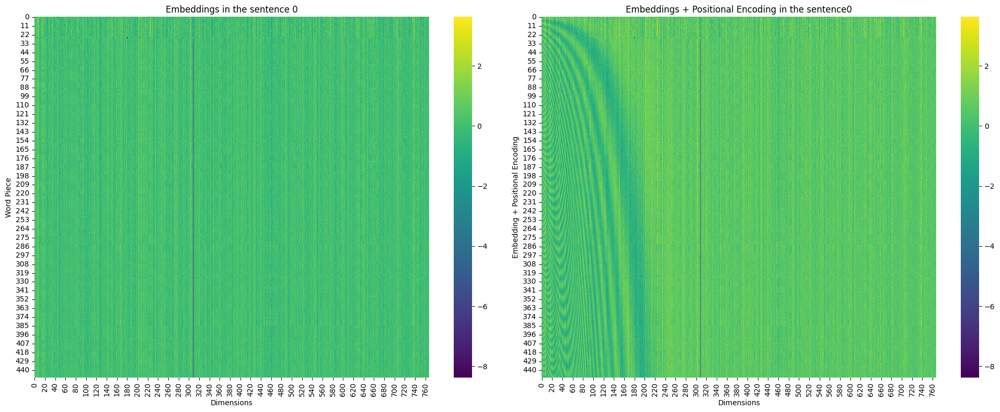

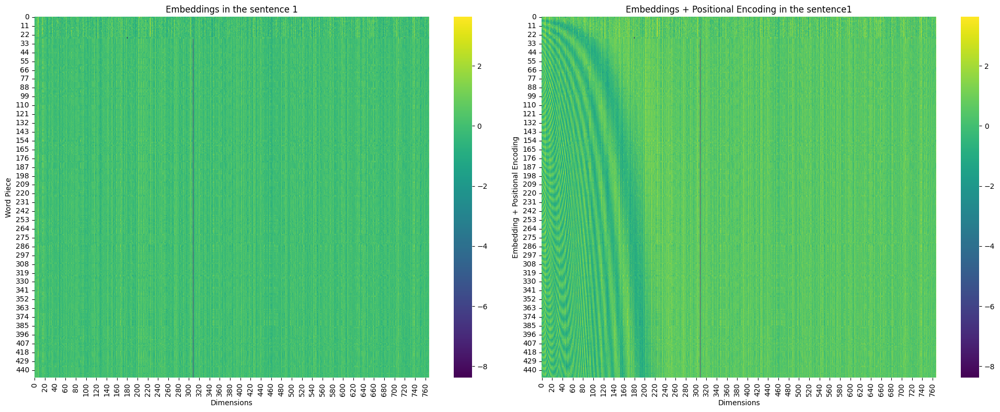

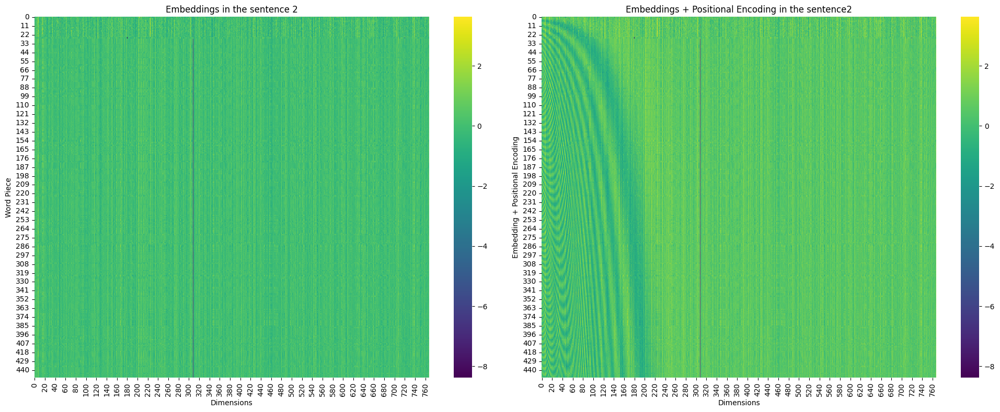

In [75]:
for i in range(outputs.shape[0]):
  vmin = embeddings[i].min()
  vmax = embeddings[i].max()
  # Configurar la figura y los subplots
  fig, axs = plt.subplots(1, 2, figsize=(20, 8))

  # Primer subplot (izquierda)
  sns.heatmap(embeddings[i], cmap='viridis', vmin=vmin, vmax=vmax, ax=axs[0])
  axs[0].set_title(f'Embeddings in the sentence {i}')
  axs[0].set_xlabel('Dimensions')
  axs[0].set_ylabel('Word Piece')
  #axs[0].set_yticks(ticks=range(16))
  #axs[0].set_yticklabels(labels=name_tokens, rotation=0)

  # Segundo subplot (derecha)
  sns.heatmap(embedding_with_pe[i], cmap='viridis', vmin=vmin, vmax=vmax, ax=axs[1])
  axs[1].set_title(f'Embeddings + Positional Encoding in the sentence{i}')
  axs[1].set_xlabel('Dimensions')
  axs[1].set_ylabel('Embedding + Positional Encoding')
  #axs[1].set_yticks(ticks=range(16))
  #axs[1].set_yticklabels(labels=name_tokens, rotation=0)

  # Mostrar el gráfico combinado
  plt.tight_layout()
  plt.show()

Ahora, probemos el posicional encoding variando la frecuencia de los senos y cosenos que lo codifican:

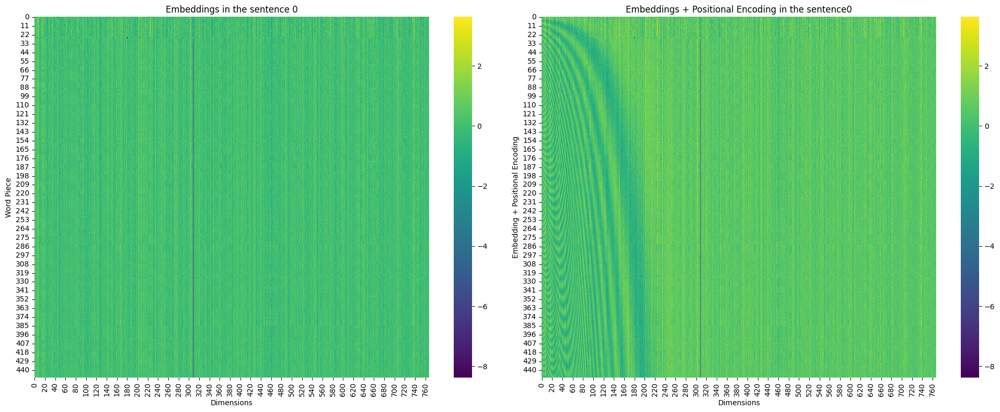

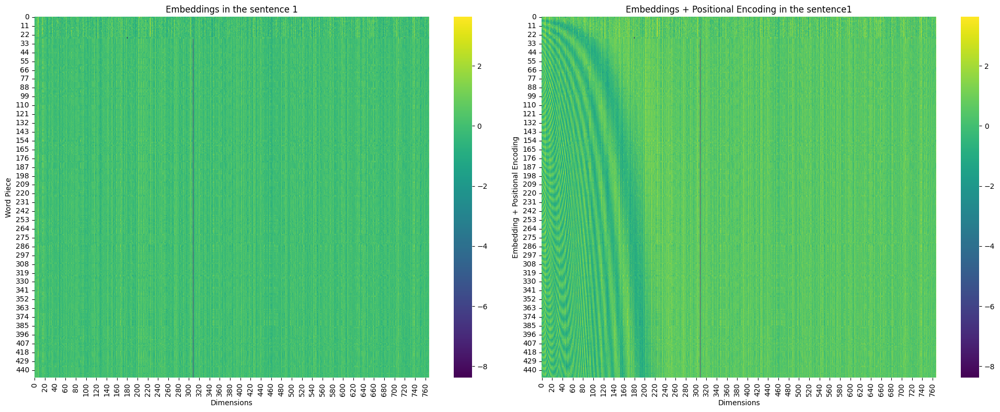

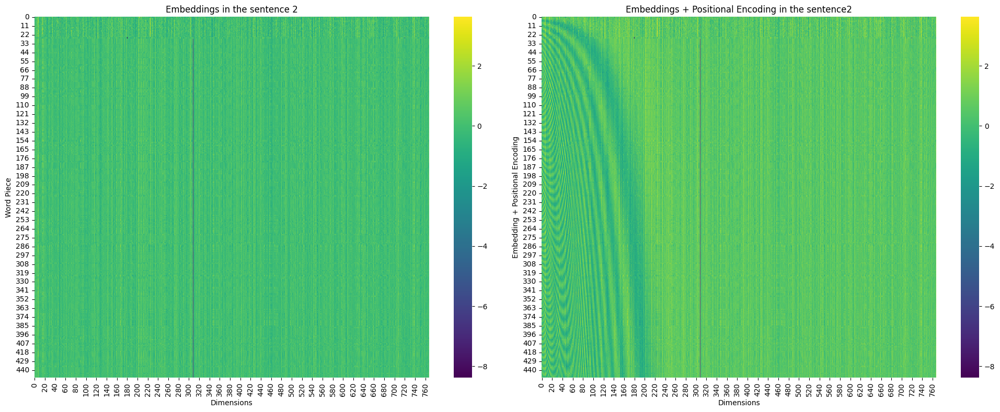

In [79]:
# Crear positional encoding
pos_enc_matrix = positional_encoding(max_len, d_model,denominator_freq=1)

embedding_with_pe=[]
for i in range(outputs.shape[0]):
  embedding_mas_pe=embeddings[i]+pos_enc_matrix
  embedding_with_pe.append(embedding_mas_pe)

for i in range(outputs.shape[0]):
  vmin = embeddings[i].min()
  vmax = embeddings[i].max()
  # Configurar la figura y los subplots
  fig, axs = plt.subplots(1, 2, figsize=(20, 8))

  # Primer subplot (izquierda)
  sns.heatmap(embeddings[i], cmap='viridis', vmin=vmin, vmax=vmax, ax=axs[0])
  axs[0].set_title(f'Embeddings in the sentence {i}')
  axs[0].set_xlabel('Dimensions')
  axs[0].set_ylabel('Word Piece')
  #axs[0].set_yticks(ticks=range(16))
  #axs[0].set_yticklabels(labels=name_tokens, rotation=0)

  # Segundo subplot (derecha)
  sns.heatmap(embedding_with_pe[i], cmap='viridis', vmin=vmin, vmax=vmax, ax=axs[1])
  axs[1].set_title(f'Embeddings + Positional Encoding in the sentence{i}')
  axs[1].set_xlabel('Dimensions')
  axs[1].set_ylabel('Embedding + Positional Encoding')
  #axs[1].set_yticks(ticks=range(16))
  #axs[1].set_yticklabels(labels=name_tokens, rotation=0)

  # Mostrar el gráfico combinado
  plt.tight_layout()
plt.show()

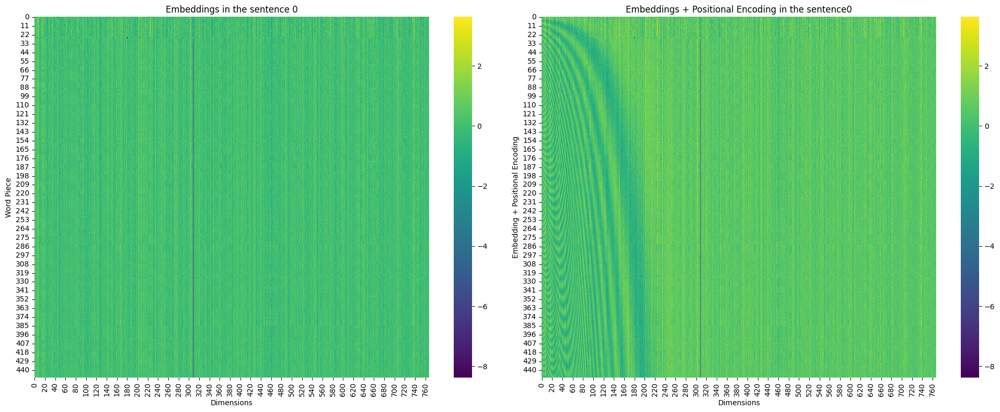

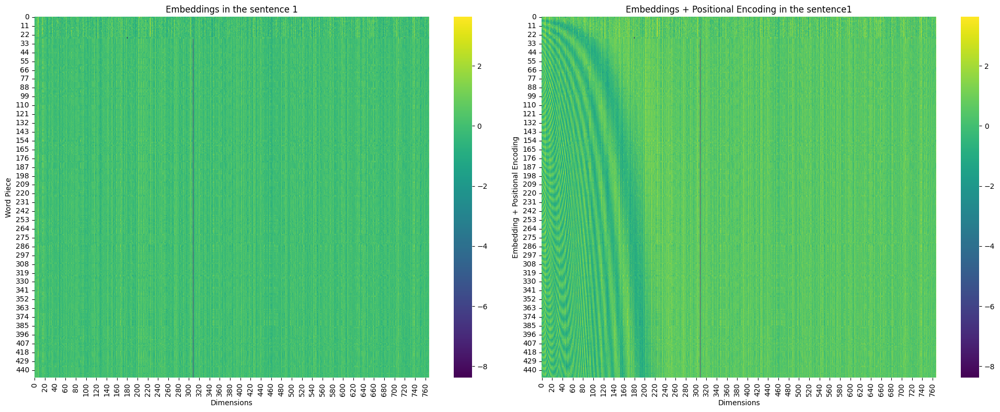

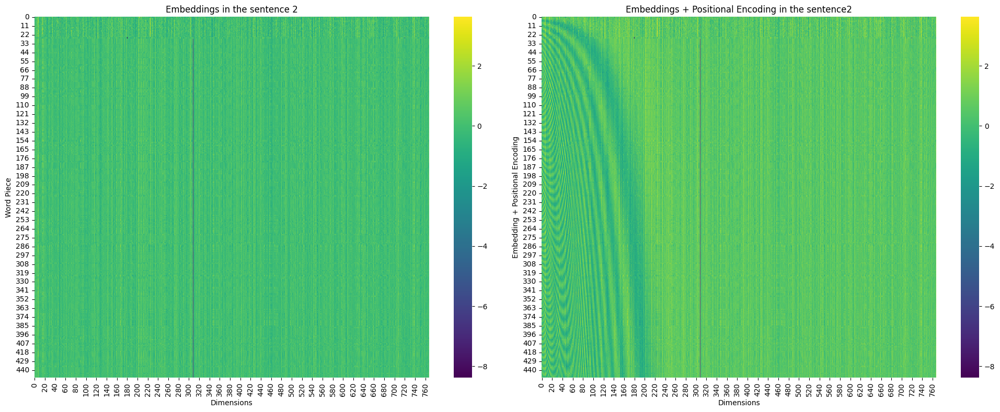

In [80]:
# Crear positional encoding
pos_enc_matrix = positional_encoding(max_len, d_model,denominator_freq=100)

embedding_with_pe=[]
for i in range(outputs.shape[0]):
  embedding_mas_pe=embeddings[i]+pos_enc_matrix
  embedding_with_pe.append(embedding_mas_pe)

for i in range(outputs.shape[0]):
  vmin = embeddings[i].min()
  vmax = embeddings[i].max()
  # Configurar la figura y los subplots
  fig, axs = plt.subplots(1, 2, figsize=(20, 8))

  # Primer subplot (izquierda)
  sns.heatmap(embeddings[i], cmap='viridis', vmin=vmin, vmax=vmax, ax=axs[0])
  axs[0].set_title(f'Embeddings in the sentence {i}')
  axs[0].set_xlabel('Dimensions')
  axs[0].set_ylabel('Word Piece')
  #axs[0].set_yticks(ticks=range(16))
  #axs[0].set_yticklabels(labels=name_tokens, rotation=0)

  # Segundo subplot (derecha)
  sns.heatmap(embedding_with_pe[i], cmap='viridis', vmin=vmin, vmax=vmax, ax=axs[1])
  axs[1].set_title(f'Embeddings + Positional Encoding in the sentence{i}')
  axs[1].set_xlabel('Dimensions')
  axs[1].set_ylabel('Embedding + Positional Encoding')
  #axs[1].set_yticks(ticks=range(16))
  #axs[1].set_yticklabels(labels=name_tokens, rotation=0)

  # Mostrar el gráfico combinado
  plt.tight_layout()
plt.show()

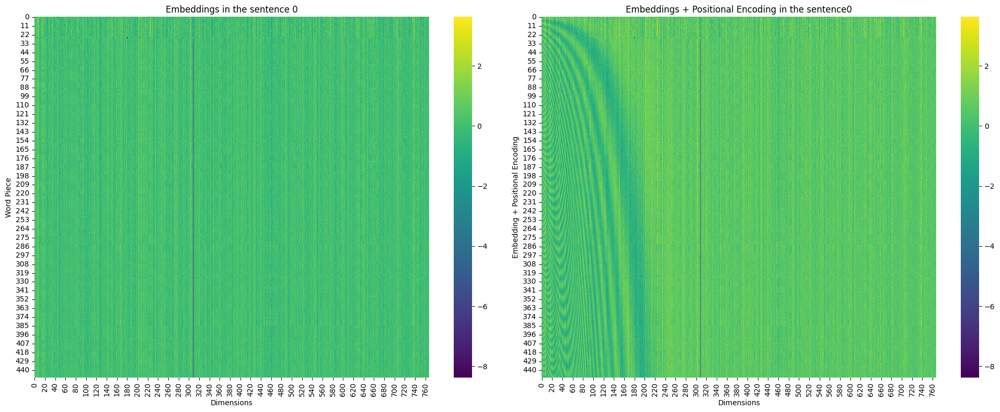

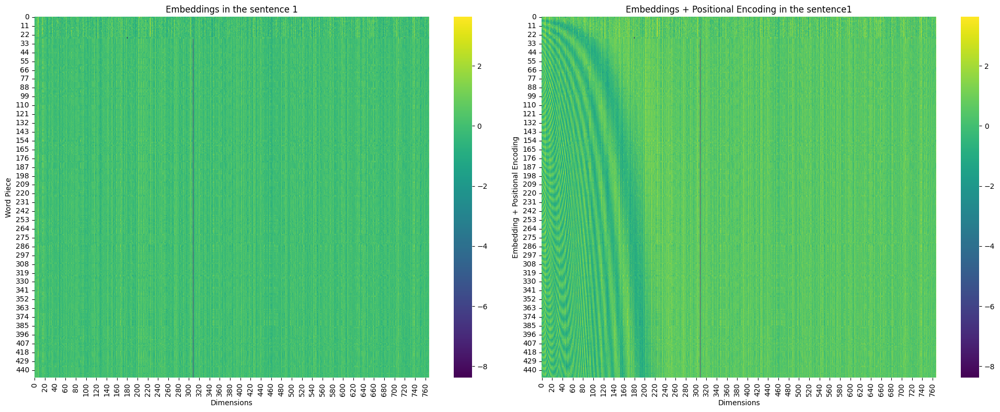

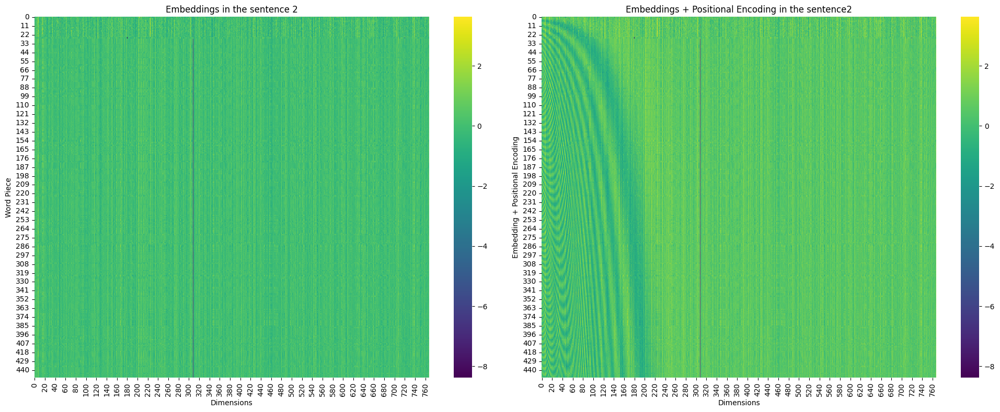

In [81]:
# Crear positional encoding
pos_enc_matrix = positional_encoding(max_len, d_model,denominator_freq=1000000000000)

embedding_with_pe=[]
for i in range(outputs.shape[0]):
  embedding_mas_pe=embeddings[i]+pos_enc_matrix
  embedding_with_pe.append(embedding_mas_pe)

for i in range(outputs.shape[0]):
  vmin = embeddings[i].min()
  vmax = embeddings[i].max()
  # Configurar la figura y los subplots
  fig, axs = plt.subplots(1, 2, figsize=(20, 8))

  # Primer subplot (izquierda)
  sns.heatmap(embeddings[i], cmap='viridis', vmin=vmin, vmax=vmax, ax=axs[0])
  axs[0].set_title(f'Embeddings in the sentence {i}')
  axs[0].set_xlabel('Dimensions')
  axs[0].set_ylabel('Word Piece')
  #axs[0].set_yticks(ticks=range(16))
  #axs[0].set_yticklabels(labels=name_tokens, rotation=0)

  # Segundo subplot (derecha)
  sns.heatmap(embedding_with_pe[i], cmap='viridis', vmin=vmin, vmax=vmax, ax=axs[1])
  axs[1].set_title(f'Embeddings + Positional Encoding in the sentence{i}')
  axs[1].set_xlabel('Dimensions')
  axs[1].set_ylabel('Embedding + Positional Encoding')
  #axs[1].set_yticks(ticks=range(16))
  #axs[1].set_yticklabels(labels=name_tokens, rotation=0)

  # Mostrar el gráfico combinado
  plt.tight_layout()
plt.show()

Como se puede ver, el positional encoding no modifica significativamente el embedding representación contextual de las palabras, lo cual es de esperar; pues la idea del positional encodding es que dé un orden a la secuencia pero sin alterar la semántica contextual de los tokens.